In [1]:
import tensorflow as tf
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import os

/Users/xiejiayu/anaconda/envs/py36/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
from tensorflow.python.framework import constant_op
from tensorflow.python.framework import dtypes
from tensorflow.python.framework import ops
from tensorflow.python.framework import tensor_shape
from tensorflow.python.framework import tensor_util
from tensorflow.python.ops import array_ops
from tensorflow.python.ops import check_ops
from tensorflow.python.ops import control_flow_ops
from tensorflow.python.ops import gen_image_ops
from tensorflow.python.ops import gen_nn_ops
from tensorflow.python.ops import math_ops
from tensorflow.python.ops import nn
from tensorflow.python.ops import nn_ops
from tensorflow.python.ops import random_ops
from tensorflow.python.ops import string_ops
from tensorflow.python.ops import variables

def _verify_compatible_image_shapes(img1, img2):
  """Checks if two image tensors are compatible for applying SSIM or PSNR.
  This function checks if two sets of images have ranks at least 3, and if the
  last three dimensions match.
  Args:
    img1: Tensor containing the first image batch.
    img2: Tensor containing the second image batch.
  Returns:
    A tuple containing: the first tensor shape, the second tensor shape, and a
    list of control_flow_ops.Assert() ops implementing the checks.
  Raises:
    ValueError: When static shape check fails.
  """
  shape1 = img1.get_shape().with_rank_at_least(3)
  shape2 = img2.get_shape().with_rank_at_least(3)
  shape1[-3:].assert_is_compatible_with(shape2[-3:])

  if shape1.ndims is not None and shape2.ndims is not None:
    for dim1, dim2 in zip(reversed(shape1[:-3]), reversed(shape2[:-3])):
      if not (dim1 == 1 or dim2 == 1 or dim1.is_compatible_with(dim2)):
        raise ValueError(
            'Two images are not compatible: %s and %s' % (shape1, shape2))

  # Now assign shape tensors.
  shape1, shape2 = array_ops.shape_n([img1, img2])

  # TODO(sjhwang): Check if shape1[:-3] and shape2[:-3] are broadcastable.
  checks = []
  checks.append(control_flow_ops.Assert(
      math_ops.greater_equal(array_ops.size(shape1), 3),
      [shape1, shape2], summarize=10))
  checks.append(control_flow_ops.Assert(
      math_ops.reduce_all(math_ops.equal(shape1[-3:], shape2[-3:])),
      [shape1, shape2], summarize=10))
  return shape1, shape2, checks


# @tf_export('image.psnr')
def psnr(a, b, max_val, name=None):
  """Returns the Peak Signal-to-Noise Ratio between a and b.
  This is intended to be used on signals (or images). Produces a PSNR value for
  each image in batch.
  The last three dimensions of input are expected to be [height, width, depth].
  Example:
  ```python
      # Read images from file.
      im1 = tf.decode_png('path/to/im1.png')
      im2 = tf.decode_png('path/to/im2.png')
      # Compute PSNR over tf.uint8 Tensors.
      psnr1 = tf.image.psnr(im1, im2, max_val=255)
      # Compute PSNR over tf.float32 Tensors.
      im1 = tf.image.convert_image_dtype(im1, tf.float32)
      im2 = tf.image.convert_image_dtype(im2, tf.float32)
      psnr2 = tf.image.psnr(im1, im2, max_val=1.0)
      # psnr1 and psnr2 both have type tf.float32 and are almost equal.
  ```
  Arguments:
    a: First set of images.
    b: Second set of images.
    max_val: The dynamic range of the images (i.e., the difference between the
      maximum the and minimum allowed values).
    name: Namespace to embed the computation in.
  Returns:
    The scalar PSNR between a and b. The returned tensor has type `tf.float32`
    and shape [batch_size, 1].
  """
  with ops.name_scope(name, 'PSNR', [a, b]):
    # Need to convert the images to float32.  Scale max_val accordingly so that
    # PSNR is computed correctly.
    max_val = math_ops.cast(max_val, a.dtype)
    max_val = convert_image_dtype(max_val, dtypes.float32)
    a = convert_image_dtype(a, dtypes.float32)
    b = convert_image_dtype(b, dtypes.float32)
    mse = math_ops.reduce_mean(math_ops.squared_difference(a, b), [-3, -2, -1])
    psnr_val = math_ops.subtract(
        20 * math_ops.log(max_val) / math_ops.log(10.0),
        np.float32(10 / np.log(10)) * math_ops.log(mse),
        name='psnr')

    _, _, checks = _verify_compatible_image_shapes(a, b)
    with ops.control_dependencies(checks):
      return array_ops.identity(psnr_val)

_SSIM_K1 = 0.01
_SSIM_K2 = 0.03


def _ssim_helper(x, y, reducer, max_val, compensation=1.0):
  r"""Helper function for computing SSIM.
  SSIM estimates covariances with weighted sums.  The default parameters
  use a biased estimate of the covariance:
  Suppose `reducer` is a weighted sum, then the mean estimators are
    \mu_x = \sum_i w_i x_i,
    \mu_y = \sum_i w_i y_i,
  where w_i's are the weighted-sum weights, and covariance estimator is
    cov_{xy} = \sum_i w_i (x_i - \mu_x) (y_i - \mu_y)
  with assumption \sum_i w_i = 1. This covariance estimator is biased, since
    E[cov_{xy}] = (1 - \sum_i w_i ^ 2) Cov(X, Y).
  For SSIM measure with unbiased covariance estimators, pass as `compensation`
  argument (1 - \sum_i w_i ^ 2).
  Arguments:
    x: First set of images.
    y: Second set of images.
    reducer: Function that computes 'local' averages from set of images.
      For non-covolutional version, this is usually tf.reduce_mean(x, [1, 2]),
      and for convolutional version, this is usually tf.nn.avg_pool or
      tf.nn.conv2d with weighted-sum kernel.
    max_val: The dynamic range (i.e., the difference between the maximum
      possible allowed value and the minimum allowed value).
    compensation: Compensation factor. See above.
  Returns:
    A pair containing the luminance measure, and the contrast-structure measure.
  """
  c1 = (_SSIM_K1 * max_val) ** 2
  c2 = (_SSIM_K2 * max_val) ** 2

  # SSIM luminance measure is
  # (2 * mu_x * mu_y + c1) / (mu_x ** 2 + mu_y ** 2 + c1).
  mean0 = reducer(x)
  mean1 = reducer(y)
  num0 = mean0 * mean1 * 2.0
  den0 = math_ops.square(mean0) + math_ops.square(mean1)
  luminance = (num0 + c1) / (den0 + c1)

  # SSIM contrast-structure measure is
  #   (2 * cov_{xy} + c2) / (cov_{xx} + cov_{yy} + c2).
  # Note that `reducer` is a weighted sum with weight w_k, \sum_i w_i = 1, then
  #   cov_{xy} = \sum_i w_i (x_i - \mu_x) (y_i - \mu_y)
  #          = \sum_i w_i x_i y_i - (\sum_i w_i x_i) (\sum_j w_j y_j).
  num1 = reducer(x * y) * 2.0
  den1 = reducer(math_ops.square(x) + math_ops.square(y))
  c2 *= compensation
  cs = (num1 - num0 + c2) / (den1 - den0 + c2)

  # SSIM score is the product of the luminance and contrast-structure measures.
  return luminance, cs


def _fspecial_gauss(size, sigma):
  """Function to mimic the 'fspecial' gaussian MATLAB function."""
  size = ops.convert_to_tensor(size, dtypes.int32)
  sigma = ops.convert_to_tensor(sigma)

  coords = math_ops.cast(math_ops.range(size), sigma.dtype)
  coords -= math_ops.cast(size - 1, sigma.dtype) / 2.0

  g = math_ops.square(coords)
  g *= -0.5 / math_ops.square(sigma)

  g = array_ops.reshape(g, shape=[1, -1]) + array_ops.reshape(g, shape=[-1, 1])
  g = array_ops.reshape(g, shape=[1, -1])  # For tf.nn.softmax().
  g = nn_ops.softmax(g)
  return array_ops.reshape(g, shape=[size, size, 1, 1])


def _ssim_per_channel(img1, img2, max_val=1.0):
  """Computes SSIM index between img1 and img2 per color channel.
  This function matches the standard SSIM implementation from:
  Wang, Z., Bovik, A. C., Sheikh, H. R., & Simoncelli, E. P. (2004). Image
  quality assessment: from error visibility to structural similarity. IEEE
  transactions on image processing.
  Details:
    - 11x11 Gaussian filter of width 1.5 is used.
    - k1 = 0.01, k2 = 0.03 as in the original paper.
  Args:
    img1: First image batch.
    img2: Second image batch.
    max_val: The dynamic range of the images (i.e., the difference between the
      maximum the and minimum allowed values).
  Returns:
    A pair of tensors containing and channel-wise SSIM and contrast-structure
    values. The shape is [..., channels].
  """
  filter_size = constant_op.constant(11, dtype=dtypes.int32)
  filter_sigma = constant_op.constant(1.5, dtype=img1.dtype)

  shape1, shape2 = array_ops.shape_n([img1, img2])
  checks = [
      control_flow_ops.Assert(math_ops.reduce_all(math_ops.greater_equal(
          shape1[-3:-1], filter_size)), [shape1, filter_size], summarize=8),
      control_flow_ops.Assert(math_ops.reduce_all(math_ops.greater_equal(
          shape2[-3:-1], filter_size)), [shape2, filter_size], summarize=8)]

  # Enforce the check to run before computation.
  with ops.control_dependencies(checks):
    img1 = array_ops.identity(img1)

  # TODO(sjhwang): Try to cache kernels and compensation factor.
  kernel = _fspecial_gauss(filter_size, filter_sigma)
  kernel = array_ops.tile(kernel, multiples=[1, 1, shape1[-1], 1])

  # The correct compensation factor is `1.0 - tf.reduce_sum(tf.square(kernel))`,
  # but to match MATLAB implementation of MS-SSIM, we use 1.0 instead.
  compensation = 1.0

  # TODO(sjhwang): Try FFT.
  # TODO(sjhwang): Gaussian kernel is separable in space. Consider applying
  #   1-by-n and n-by-1 Gaussain filters instead of an n-by-n filter.
  def reducer(x):
    shape = array_ops.shape(x)
    x = array_ops.reshape(x, shape=array_ops.concat([[-1], shape[-3:]], 0))
    y = nn.depthwise_conv2d(x, kernel, strides=[1, 1, 1, 1], padding='VALID')
    return array_ops.reshape(y, array_ops.concat([shape[:-3],
                                                  array_ops.shape(y)[1:]], 0))

  luminance, cs = _ssim_helper(img1, img2, reducer, max_val, compensation)

  # Average over the second and the third from the last: height, width.
  axes = constant_op.constant([-3, -2], dtype=dtypes.int32)
  ssim_val = math_ops.reduce_mean(luminance * cs, axes)
  cs = math_ops.reduce_mean(cs, axes)
  return ssim_val, cs


# @tf_export('image.ssim')
def ssim(img1, img2, max_val):
  """Computes SSIM index between img1 and img2.
  This function is based on the standard SSIM implementation from:
  Wang, Z., Bovik, A. C., Sheikh, H. R., & Simoncelli, E. P. (2004). Image
  quality assessment: from error visibility to structural similarity. IEEE
  transactions on image processing.
  Note: The true SSIM is only defined on grayscale.  This function does not
  perform any colorspace transform.  (If input is already YUV, then it will
  compute YUV SSIM average.)
  Details:
    - 11x11 Gaussian filter of width 1.5 is used.
    - k1 = 0.01, k2 = 0.03 as in the original paper.
  The image sizes must be at least 11x11 because of the filter size.
  Example:
  ```python
      # Read images from file.
      im1 = tf.decode_png('path/to/im1.png')
      im2 = tf.decode_png('path/to/im2.png')
      # Compute SSIM over tf.uint8 Tensors.
      ssim1 = tf.image.ssim(im1, im2, max_val=255)
      # Compute SSIM over tf.float32 Tensors.
      im1 = tf.image.convert_image_dtype(im1, tf.float32)
      im2 = tf.image.convert_image_dtype(im2, tf.float32)
      ssim2 = tf.image.ssim(im1, im2, max_val=1.0)
      # ssim1 and ssim2 both have type tf.float32 and are almost equal.
  ```
  Args:
    img1: First image batch.
    img2: Second image batch.
    max_val: The dynamic range of the images (i.e., the difference between the
      maximum the and minimum allowed values).
  Returns:
    A tensor containing an SSIM value for each image in batch.  Returned SSIM
    values are in range (-1, 1], when pixel values are non-negative. Returns
    a tensor with shape: broadcast(img1.shape[:-3], img2.shape[:-3]).
  """
  _, _, checks = _verify_compatible_image_shapes(img1, img2)
  with ops.control_dependencies(checks):
    img1 = array_ops.identity(img1)

  # Need to convert the images to float32.  Scale max_val accordingly so that
  # SSIM is computed correctly.
  max_val = math_ops.cast(max_val, img1.dtype)
  max_val = convert_image_dtype(max_val, dtypes.float32)
  img1 = convert_image_dtype(img1, dtypes.float32)
  img2 = convert_image_dtype(img2, dtypes.float32)
  ssim_per_channel, _ = _ssim_per_channel(img1, img2, max_val)
  # Compute average over color channels.
  return math_ops.reduce_mean(ssim_per_channel, [-1])

def convert_image_dtype(image, dtype, saturate=False, name=None):
  """Convert `image` to `dtype`, scaling its values if needed.
  Images that are represented using floating point values are expected to have
  values in the range [0,1). Image data stored in integer data types are
  expected to have values in the range `[0,MAX]`, where `MAX` is the largest
  positive representable number for the data type.
  This op converts between data types, scaling the values appropriately before
  casting.
  Note that converting from floating point inputs to integer types may lead to
  over/underflow problems. Set saturate to `True` to avoid such problem in
  problematic conversions. If enabled, saturation will clip the output into the
  allowed range before performing a potentially dangerous cast (and only before
  performing such a cast, i.e., when casting from a floating point to an integer
  type, and when casting from a signed to an unsigned type; `saturate` has no
  effect on casts between floats, or on casts that increase the type's range).
  Args:
    image: An image.
    dtype: A `DType` to convert `image` to.
    saturate: If `True`, clip the input before casting (if necessary).
    name: A name for this operation (optional).
  Returns:
    `image`, converted to `dtype`.
  """
  image = ops.convert_to_tensor(image, name='image')
  if dtype == image.dtype:
    return array_ops.identity(image, name=name)

  with ops.name_scope(name, 'convert_image', [image]) as name:
    # Both integer: use integer multiplication in the larger range
    if image.dtype.is_integer and dtype.is_integer:
      scale_in = image.dtype.max
      scale_out = dtype.max
      if scale_in > scale_out:
        # Scaling down, scale first, then cast. The scaling factor will
        # cause in.max to be mapped to above out.max but below out.max+1,
        # so that the output is safely in the supported range.
        scale = (scale_in + 1) // (scale_out + 1)
        scaled = math_ops.div(image, scale)

        if saturate:
          return math_ops.saturate_cast(scaled, dtype, name=name)
        else:
          return math_ops.cast(scaled, dtype, name=name)
      else:
        # Scaling up, cast first, then scale. The scale will not map in.max to
        # out.max, but converting back and forth should result in no change.
        if saturate:
          cast = math_ops.saturate_cast(image, dtype)
        else:
          cast = math_ops.cast(image, dtype)
        scale = (scale_out + 1) // (scale_in + 1)
        return math_ops.multiply(cast, scale, name=name)
    elif image.dtype.is_floating and dtype.is_floating:
      # Both float: Just cast, no possible overflows in the allowed ranges.
      # Note: We're ignoreing float overflows. If your image dynamic range
      # exceeds float range you're on your own.
      return math_ops.cast(image, dtype, name=name)
    else:
      if image.dtype.is_integer:
        # Converting to float: first cast, then scale. No saturation possible.
        cast = math_ops.cast(image, dtype)
        scale = 1. / image.dtype.max
        return math_ops.multiply(cast, scale, name=name)
      else:
        # Converting from float: first scale, then cast
        scale = dtype.max + 0.5  # avoid rounding problems in the cast
        scaled = math_ops.multiply(image, scale)
        if saturate:
          return math_ops.saturate_cast(scaled, dtype, name=name)
        else:
          return math_ops.cast(scaled, dtype, name=name)

In [3]:

def random_like(matrix):
    ## return a random float ndarray in [0,1) with the same shape like input matrix. 
    ## Input : 
    ##    matrix: numpy ndarray
    ## Output :
    ##    out: numpy float ndarray in [0,1) 
    
    return np.random.random(np.shape(matrix))

def add_impulsive_noise(image,p = 0.1 ,show_p = False,random = False):
    ## Add impulsive noise with probability p
    ## Input : 
    ##    image: numpy ndarray
    ##    p: float in (0,1), the noise probability
    ## Output :
    ##    out: numpy ndarray 
    
    if show_p:
        print (p)
    random_image = random_like(image)
    salt_position = np.where(random_image <= p/2 )
    pepper_position = np.where((random_image > p/2) & (random_image <= p))
    noise_image = np.copy(image)
    if random == False:
        noise_image[salt_position] = 255
        noise_image[pepper_position] = 0
    else:
        noise = np.random.randint(256,size=noise_image.shape)
        noise_image[salt_position] = noise[salt_position]
        noise_image[pepper_position] = noise[pepper_position]
    return noise_image

def load_image(filepath):
    im = Image.open(filepath)
    return im

def pil2array(image):
    return np.array(image,dtype='float32')

def array2pil(array):
    im = Image.fromarray(np.uint8(array))
    return im

def PSNR(im_label,im_correct):
    im_label = np.asarray(im_label,dtype="float32")
    im_correct = np.asarray(im_correct,dtype="float32")
    MSE = np.mean(np.square(im_label-im_correct))
    return 20*np.log10(255) - 10*np.log10(MSE)

In [4]:
class Preprocess():
    def __init__(self,file_path,img_size=[180,180]):
        self.im_train_list = []
        for root, dirs, files in os.walk(file_path):  
            for file in files:
                if file.split('.')[-1] == 'png':
                    im = load_image(root+'/'+file)
                    print (root+'/'+file)
                    self.im_train_list.append(pil2array(im.resize(img_size)))
        self.im_size = self.im_train_list[0].shape
        
    def next_train_batch(self,batch_size=32,show_p=False,random=False,p=None):
        train_x = []
        train_y = []
        for i in range(batch_size):
            if not p:
                p = np.random.rand(1)/1.25
            n = np.random.randint(len(self.im_train_list))
            train_x.append(np.expand_dims(add_impulsive_noise(self.im_train_list[n],
                                                              p,
                                                              show_p=show_p,
                                                              random=random),
                                          axis=0))
            train_y.append(np.expand_dims(self.im_train_list[n],axis=0))
        return np.vstack(train_x),np.vstack(train_y)
    
    def test_batch(self,random=False):
        train_x = []
        train_y = []
        for i in range(len(self.im_train_list)):
            
            for p in [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0]:
#             for p in [0.1,0.15,0.2,0.25,0.3]:
                p = p/1.25
                train_x.append(np.expand_dims(add_impulsive_noise(self.im_train_list[i],
                                                                  p,
                                                                  show_p=False,
                                                                  random=random),
                                              axis=0))
                train_y.append(np.expand_dims(self.im_train_list[i],axis=0))
        return np.vstack(train_x),np.vstack(train_y)
        

In [5]:
pre = Preprocess('./train400',[96,96])

./train400/test_007.png
./train400/test_013.png
./train400/test_239.png
./train400/test_205.png
./train400/test_211.png
./train400/test_359.png
./train400/test_371.png
./train400/test_365.png
./train400/test_173.png
./train400/test_167.png
./train400/test_198.png
./train400/test_199.png
./train400/test_166.png
./train400/test_172.png
./train400/test_364.png
./train400/test_370.png
./train400/test_358.png
./train400/test_210.png
./train400/test_204.png
./train400/test_238.png
./train400/test_012.png
./train400/test_006.png
./train400/test_038.png
./train400/test_010.png
./train400/test_004.png
./train400/test_212.png
./train400/test_206.png
./train400/test_400.png
./train400/test_366.png
./train400/test_372.png
./train400/test_399.png
./train400/test_158.png
./train400/test_164.png
./train400/test_170.png
./train400/test_171.png
./train400/test_165.png
./train400/test_159.png
./train400/test_398.png
./train400/test_373.png
./train400/test_367.png
./train400/test_207.png
./train400/test_

In [6]:
x,y = pre.next_train_batch()

In [7]:
x.shape

(32, 96, 96)

In [8]:
class CNNmodel():
    def __init__(self,learning_rate):
        self.graph = tf.Graph()
        with self.graph.as_default():
            self.x = tf.placeholder(name="input_x",shape=[None,None,None],dtype=tf.float32)
            self.y = tf.placeholder(name="input_y",shape=[None,None,None],dtype=tf.float32)

            x_reshaped = tf.expand_dims(self.x,axis=-1)
            y_reshaped = tf.expand_dims(self.y,axis=-1)

            conv1_res = tf.layers.conv2d(
                      inputs=x_reshaped,
                      filters=32,
                      kernel_size=[1, 1],
                      padding="same",
                      activation=tf.nn.relu)

            self.conv1_res = conv1_res
            
            conv1 = tf.layers.conv2d(
                      inputs=x_reshaped,
                      filters=32,
                      kernel_size=[3, 3],
                      padding="same",
                      activation=tf.nn.relu)
            
            self.conv1 = conv1

            pool1 = tf.layers.max_pooling2d(inputs=conv1, pool_size=[2, 2], strides=2)

            self.pool1 = pool1
            
            conv2 = tf.layers.conv2d(
                      inputs=pool1,
                      filters=64,
                      kernel_size=[3, 3],
                      padding="same",
                      activation=tf.nn.relu)
            
            self.conv2 = conv2

            pool2 = tf.layers.max_pooling2d(inputs=conv2, pool_size=[2, 2], strides=2)

            conv3 = tf.layers.conv2d(
                      inputs=pool2,
                      filters=128,
                      kernel_size=[3, 3],
                      padding="same",
                      activation=tf.nn.relu)
            
            self.conv3 = conv3

            conv3_up = tf.layers.conv2d_transpose(
                        inputs=conv3,
                        filters=64,
                        kernel_size=[2, 2],
                        padding="valid",
                        strides=(2, 2),
                        activation=tf.nn.relu
                    )
            
            self.conv3_up = conv3_up

            conv4 = tf.layers.conv2d(
                      inputs=tf.concat([conv2,conv3_up],axis=-1),
                      filters=64,
                      kernel_size=[3, 3],
                      padding="same",
                      activation=tf.nn.relu)
            
            self.conv4 = conv4

            conv4_up = tf.layers.conv2d_transpose(
                        inputs=conv4,
                        filters=32,
                        kernel_size=[2, 2],
                        padding="valid",
                        strides=(2, 2),
                        activation=tf.nn.relu
                    )
            
            self.conv4_up = conv4_up

            conv5 = tf.layers.conv2d(
                      inputs=tf.concat([conv4_up,conv1],axis=-1),
                      filters=32,
                      kernel_size=[3, 3],
                      padding="same",
                      activation=tf.nn.relu)
            
            self.conv5 = conv5

            self.conv6 = tf.layers.conv2d(
                      inputs=conv5 + conv1_res,
                      filters=1,
                      kernel_size=[3, 3],
                      padding="same",
                      activation=tf.nn.relu)

            self.output = self.conv6

            self.l2_loss = tf.reduce_mean(tf.square(self.output - y_reshaped))
            
            self.ssim = tf.reduce_mean(ssim(self.output,y_reshaped,255))
            
            self.train_loss = self.l2_loss - 200*self.ssim

            self.train_op = tf.train.AdamOptimizer(learning_rate).minimize(self.train_loss)

            MSE = tf.reduce_mean(tf.square(y_reshaped - self.output)) 
            self.psnr = 20*self.log10(255) - 10*self.log10(MSE)
        
    def train(self,epoches,pre,test_pre,batch_size=128,init=True):
        if init:
            self.sess = tf.InteractiveSession(graph=self.graph)
            init = tf.global_variables_initializer()
            self.sess.run(init)
#             tf.variables_initializer()
            self.saver = tf.train.Saver()
            self.best_performance = 0

        test_x,test_y = test_pre.test_batch()
        test_feed_dict = {self.x:test_x,
                        self.y:test_y}
        
        for i in range(epoches):
            x,y = pre.next_train_batch(batch_size=batch_size)
            feed_dict = {self.x:x,
                        self.y:y}
            _,loss,ssim,l2_loss = self.sess.run([self.train_op,self.train_loss,self.ssim,self.l2_loss],
                                   feed_dict=feed_dict)
            
            if i%100 == 0:
                print (i,"LOSS:",loss, "ssim:",ssim,"l2_loss:",l2_loss)
                performance = self.test_batch(test_feed_dict)
                if performance > self.best_performance:
                    self.save(self.saver)
                    print ("BEST PERFORMANCE:",performance)
                    self.best_performance = performance
                    
    def log10(self,x):
        return tf.log(tf.cast(x,dtype=tf.float32))/tf.log(10.)
                
    def save(self,saver):
        if not saver:
            saver = tf.train.Saver()
        saver.save(self.sess, '.\CNN')
                
    def test_batch(self,test_feed_dict):
        
        psnr = self.sess.run(self.psnr,feed_dict=test_feed_dict)
        print (psnr)
        return psnr
    
    def load(self,last_best_performance):
        if last_best_performance:
            self.best_performance = last_best_performance
        else:
            self.best_performance = 0
        self.sess = tf.InteractiveSession(graph=self.graph)
        self.saver = tf.train.Saver()
        self.saver.restore(self.sess, "./CNN")
        

In [9]:
model = CNNmodel(5e-4)
model.load(27.0763)

INFO:tensorflow:Restoring parameters from ./CNN


In [165]:
test_pre = Preprocess('./Test/Set12/256',[256,256])

In [125]:
model.train(4000,pre,test_pre,init = False,batch_size=64)

0 LOSS: -34.8239 ssim: 0.885637 l2_loss: 142.304
26.9229
100 LOSS: -57.7541 ssim: 0.87679 l2_loss: 117.604
26.7373
200 LOSS: -81.5764 ssim: 0.888462 l2_loss: 96.116
26.7194
300 LOSS: -93.9485 ssim: 0.8953 l2_loss: 85.1115
26.9162
400 LOSS: -58.5337 ssim: 0.896789 l2_loss: 120.824
26.7845
500 LOSS: -37.1366 ssim: 0.854608 l2_loss: 133.785
26.6695
600 LOSS: -49.4353 ssim: 0.86067 l2_loss: 122.699
26.9278
700 LOSS: -66.3318 ssim: 0.886904 l2_loss: 111.049
26.9273
800 LOSS: -85.8156 ssim: 0.889774 l2_loss: 92.1392
26.7979
900 LOSS: -40.4974 ssim: 0.860855 l2_loss: 131.674
26.9384
1000 LOSS: -66.8913 ssim: 0.880176 l2_loss: 109.144
26.7856
1100 LOSS: -27.6415 ssim: 0.878293 l2_loss: 148.017
26.811
1200 LOSS: -23.1462 ssim: 0.858372 l2_loss: 148.528
26.1653
1300 LOSS: -57.7613 ssim: 0.880988 l2_loss: 118.436
26.7985
1400 LOSS: -45.7589 ssim: 0.876174 l2_loss: 129.476
26.5995
1500 LOSS: -46.3342 ssim: 0.871635 l2_loss: 127.993
26.9583
BEST PERFORMANCE: 26.9583
1600 LOSS: -73.7264 ssim: 0.8895

In [18]:
test_pre = Preprocess('./Test/Set12')

./Test/Set12/01.png
./Test/Set12/03.png
./Test/Set12/02.png
./Test/Set12/06.png
./Test/Set12/12.png
./Test/Set12/07.png
./Test/Set12/11.png
./Test/Set12/05.png
./Test/Set12/04.png
./Test/Set12/10.png
./Test/Set12/09.png
./Test/Set12/08.png


In [9]:
x,y = test_pre.next_train_batch(batch_size=1,show_p=True,p=0.1)
feed_dict = {model.x:x,model.y:y}

0.1


NameError: name 'model' is not defined

In [232]:
y = np.expand_dims(np.zeros([8,8]),0) + 100
x = np.copy(y)
x[:,4,4] = 0
feed_dict = {model.x:x,model.y:y}

In [248]:
predict,psnr,conv1_res,conv1,pool1,conv2,conv3,conv3_up,conv4,conv4_up,conv5 = model.sess.run([model.output,model.psnr,
                                                          model.conv1_res,
                                                          model.conv1,
                                                          model.pool1,
                                                          model.conv2,
                                                          model.conv3,
                                                                model.conv3_up,
                                                                         model.conv4,
                                                                               model.conv4_up,
                                                                                        model.conv5],feed_dict=feed_dict)

In [249]:
print (psnr)
predict.shape

34.70722


(1, 256, 256, 1)

In [190]:
def show_images(images):
    plt.figure(figsize=(40,int(80/32*images.shape[-1]))) 
    for i in range(images.shape[-1]):  
        plt.subplot(images.shape[-1]/4,4,i+1)
        plt.imshow(np.squeeze(images[:,:,:,i]), cmap='gray')

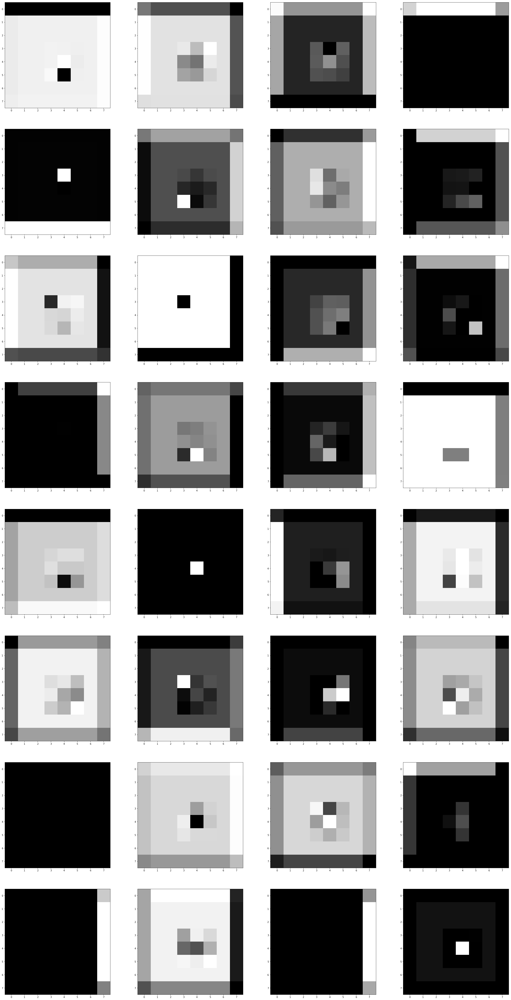

In [235]:
show_images(conv1)

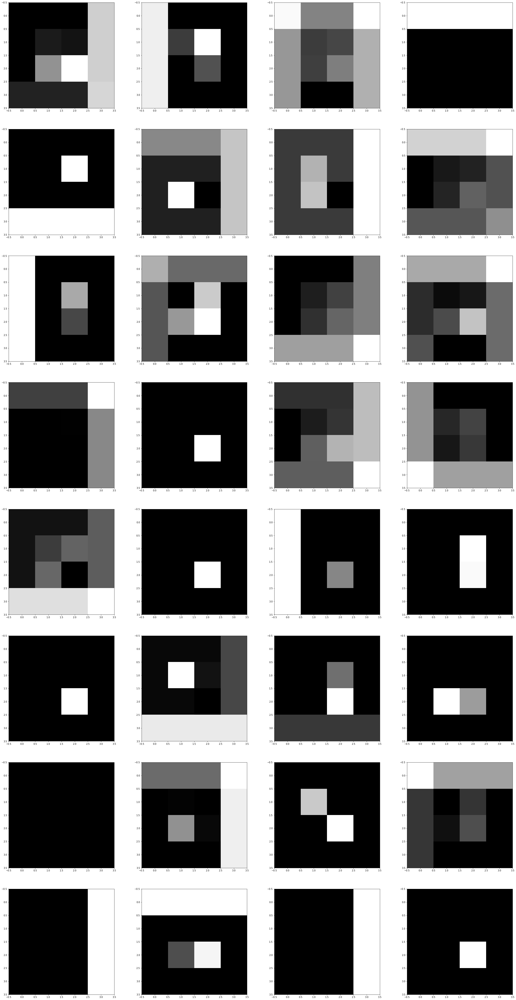

In [242]:
show_images(pool1)

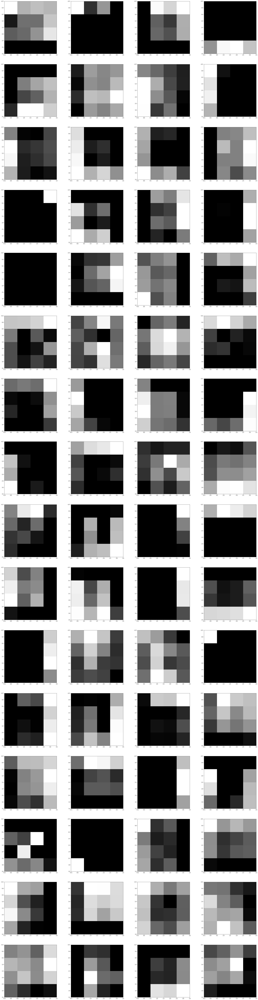

In [243]:
show_images(conv2)

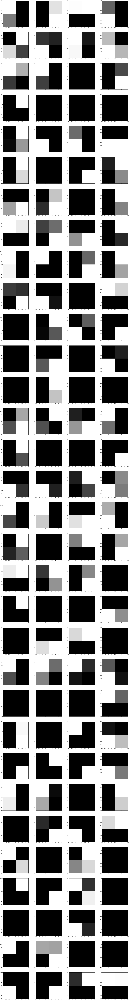

In [244]:
show_images(conv3)

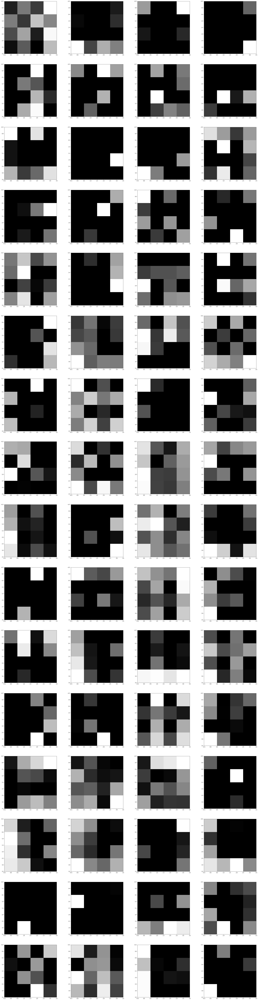

In [245]:
show_images(conv3_up)

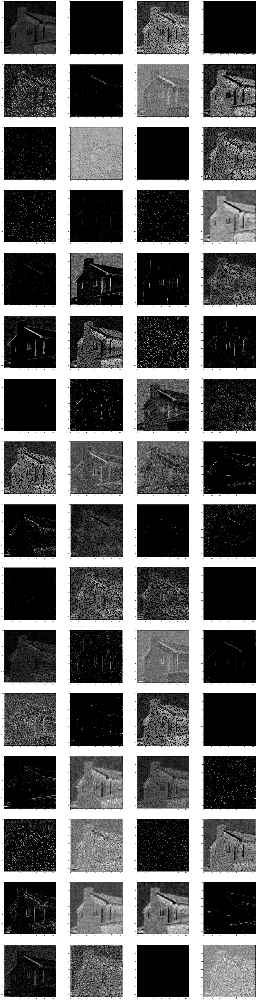

In [227]:
show_images(conv4)

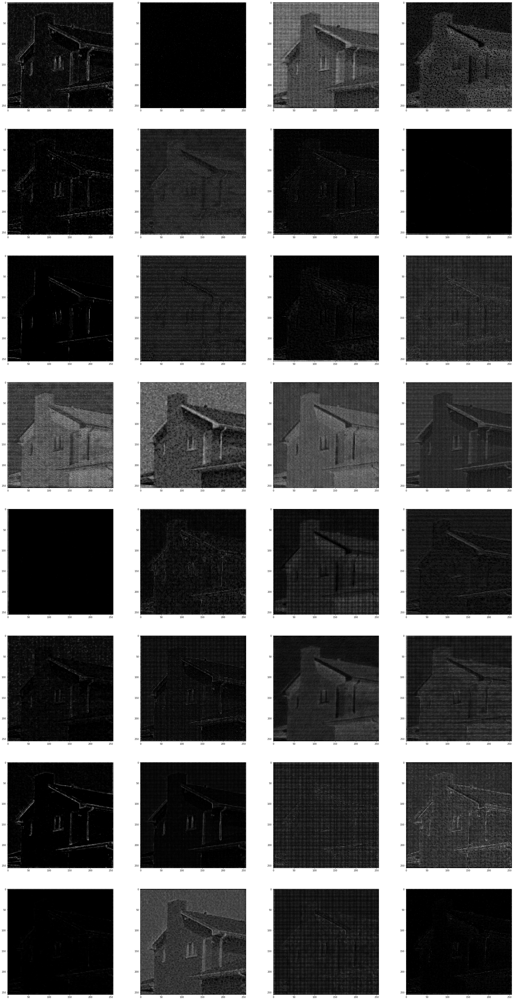

In [228]:
show_images(conv4_up)

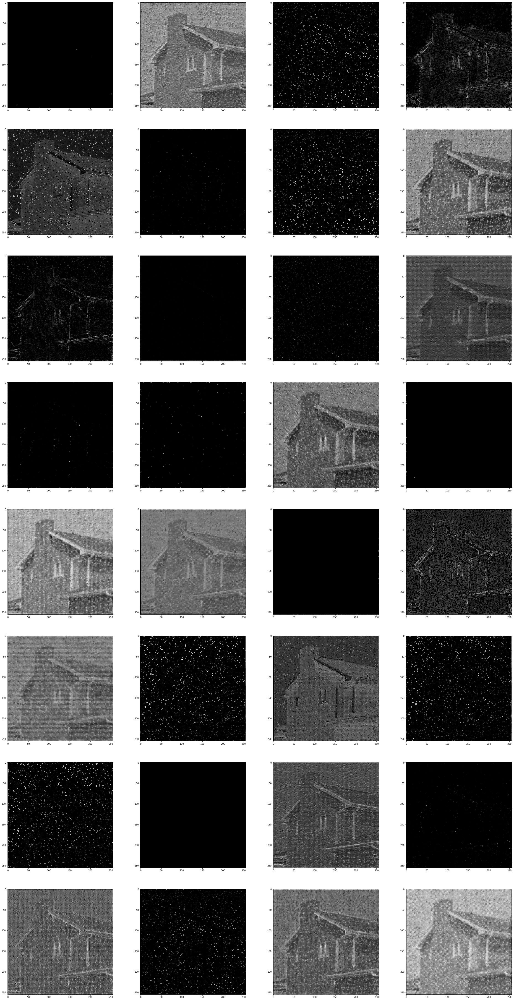

In [229]:
show_images(conv5)

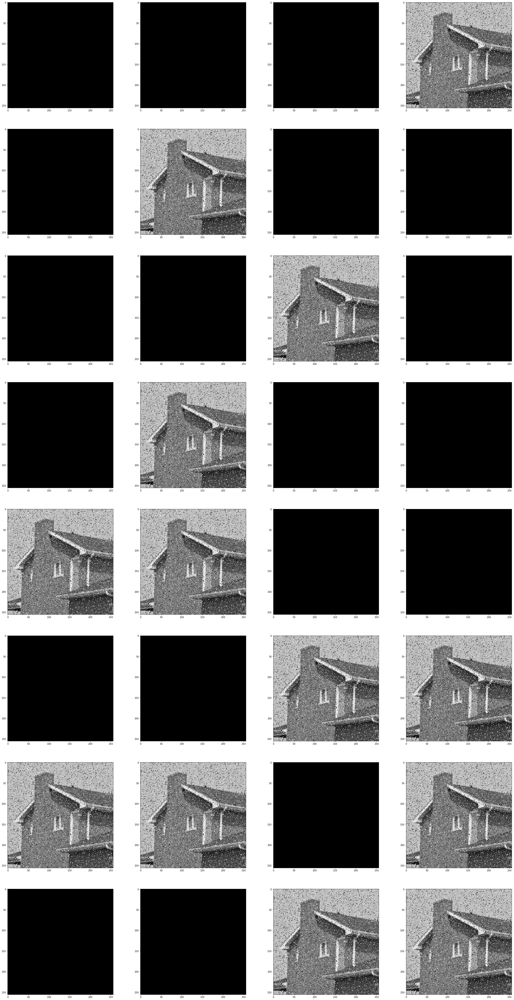

In [230]:
show_images(conv1_res)

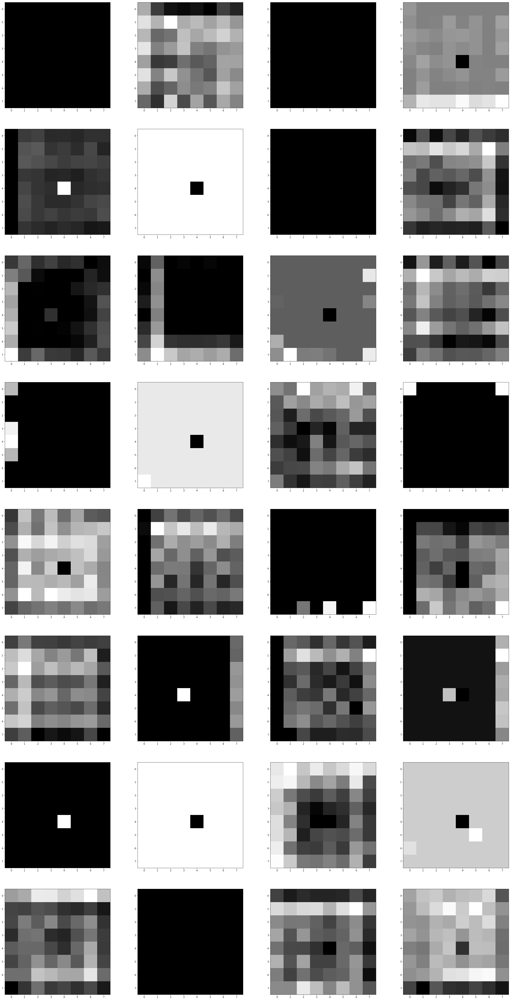

In [246]:
show_images(conv5+conv1_res)

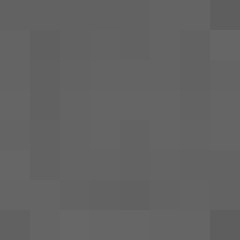

In [239]:
array2pil(np.reshape(predict,[x.shape[1],x.shape[1]])).resize([x.shape[1],x.shape[1]])

In [262]:
array2pil(np.reshape(y,[x.shape[1],x.shape[1]])).resize([x.shape[1],x.shape[1]]).save('clean_0.7.png')


In [263]:
array2pil(np.reshape(x,[x.shape[1],x.shape[1]])).resize([x.shape[1],x.shape[1]]).save('noise_0.7.png')

In [37]:
PSNR(y,np.reshape(predict,[1,256,256]))

ValueError: cannot reshape array of size 262144 into shape (1,256,256)

In [27]:
class Basic_Ordering_model():
    def _filter(self,subimage):
        pass
    
    def _apply_filter(self,image,filter_function,height,width):
        clean_im = np.zeros_like(image)
        for x in range(height):
            for y in range(width):
                subimage = self._get_subimage((x,y),image,height,width)
                filter_out = filter_function(subimage)
                clean_im[x,y] = filter_out
                
        return clean_im
    
    def _get_subimage(self,position,image,height,width):
        p_x,p_y = position
        sub_sx = max(p_x - self.window_size,0)
        sub_lx = min(height, p_x + self.window_size + 1)
        
        sub_sy = max(p_y - self.window_size,0)
        sub_ly = min(width, p_y + self.window_size + 1) 
        
        if len(image.shape) == 3:
            return image[sub_sx:sub_lx,sub_sy:sub_ly,:]
        if len(image.shape) == 2:
            return image[sub_sx:sub_lx,sub_sy:sub_ly]

In [28]:
class VMF(Basic_Ordering_model):
    def _distance_sort(self,reshaped_subim,x_i):
        unsort_ls = np.linalg.norm(reshaped_subim-x_i,axis=1)
        return unsort_ls
    
    def _filter(self,subimage,*args):
        height, width = subimage.shape
        reshaped_subim = np.reshape(subimage,[height*width,1])
        
        D_list = []
        for x in range(height):
            for y in range(width):
                x_i = subimage[x,y]
                D_list.append(np.sum(self._distance_sort(reshaped_subim,x_i)))
        
        (min_x,min_y) = np.unravel_index(np.argmin(D_list),(height,width))
        return np.copy(subimage[min_x:min_x+1,min_y:min_y+1])
    
                 
    def run(self,image,window_size = 1):
        image = np.asarray(image,dtype="float32")
        self.window_size = window_size
        height, width = image.shape
        
        clean_im = self._apply_filter(image,self._filter,height,width)
                
        return clean_im

In [29]:
vmf = VMF()

In [97]:
cleand_im = vmf.run(np.reshape(x,[x.shape[1],x.shape[1]]))

26.7102937935


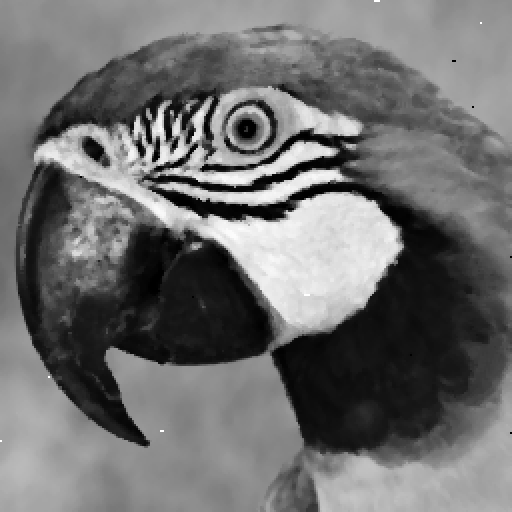

In [98]:
print (PSNR(y,cleand_im))
array2pil(cleand_im).resize((512,512))


In [29]:
np.mean((cleand_im-y)**2)

7853.2725

In [ ]:
plt.hist(cleand_im.flatten())
plt.show()

In [ ]:
plt.hist(y.flatten())
plt.show()

In [ ]:
plt.hist(predict.flatten())
plt.show()

In [82]:
np.save("test_nose_original",np.vstack([x,y]))

In [197]:
import scipy.io

In [85]:
scipy.io.savemat('test_nose_original.mat', mdict={'x': x,'y':y})

In [53]:
file_path = '/Users/xiejiayu/Desktop/啥都有/学术/MSc/Project/cnn_res_ssim_27.07/train_original_set/house'
bad_im_path = '/Users/xiejiayu/Desktop/啥都有/学术/MSc/Project/cnn_res_ssim_27.07/train_original_set/2595447924_cae898613f.jpg'
bad_im = load_image(bad_im_path)

In [54]:
# self.im_train_list = []
for root, dirs, files in os.walk(file_path):  
    for file in files:
        if file.split('.')[-1] == 'jpg':
            try:
                im = load_image(root+'/'+file).convert('LA')
            except:
                print ("error")
            w,h = im.size
            if w >= 180+50 and h >= 180+50 and pil2array(im) != pil2array(bad_im):
                crop_rectangle = (50, 50, 180+50, 180+50)
                cropped_im = im.crop(crop_rectangle)
                
#                 im = im.resize([180,180])
                cropped_im.save("/Users/xiejiayu/Desktop/啥都有/学术/MSc/Project/train_set/house/"+file.split('.')[0]+"_gray.png")

#             print (files_im)
#     for file in files:
#         if file.split('.')[-1] == 'png':
#             im = load_image(root+'/'+file)
#             self.im_train_list.append(pil2array(im))
# self.im_size = self.im_train_list[0].shape

/Users/xiejiayu/anaconda/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:10: DeprecationWarning: elementwise != comparison failed; this will raise an error in the future.
  # Remove the CWD from sys.path while we load stuff.


error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error
error


In [31]:
cropped_im

array([[[238., 255.],
        [238., 255.],
        [238., 255.],
        ...,
        [238., 255.],
        [238., 255.],
        [238., 255.]],

       [[238., 255.],
        [255., 255.],
        [255., 255.],
        ...,
        [255., 255.],
        [255., 255.],
        [255., 255.]],

       [[238., 255.],
        [255., 255.],
        [255., 255.],
        ...,
        [255., 255.],
        [255., 255.],
        [255., 255.]],

       ...,

       [[238., 255.],
        [255., 255.],
        [255., 255.],
        ...,
        [255., 255.],
        [255., 255.],
        [255., 255.]],

       [[238., 255.],
        [255., 255.],
        [255., 255.],
        ...,
        [255., 255.],
        [255., 255.],
        [255., 255.]],

       [[238., 255.],
        [255., 255.],
        [255., 255.],
        ...,
        [255., 255.],
        [255., 255.],
        [255., 255.]]], dtype=float32)

In [51]:
urls_path = '/Users/xiejiayu/Desktop/啥都有/学术/MSc/Project/urls/house.txt'
f = open(urls_path)

In [52]:
for n,line in enumerate(f.readlines()):
    if n < 400:
        url = line
        name = url.split("/")[-1].split('.')[0]+'.jpg'
        try:
            urllib.request.urlretrieve(url,"./train_original_set/house/"+name)
        except:
            print (n)

0
1
6
15
18
26
29
35
38
41
45
46
48
55
61
65
69
76
78
86
91
99
106
115
120
121
141
142
147
148
159
166
173
174
177
206
223
240
242
265
269
273
274
288
289
293
295
307
311
314
317
319
323
332
333
335
338
339
340
343
353
358
359
364
365
366
373
376
381
391
393
397
399


In [3]:
import urllib  

In [6]:
urllib.request.urlretrieve('http://www.sauer-thompson.com/junkforcode/archives/2008/03/22/Van%20GoghTreeTrunksinGrass.jpg', "2946102733_9b9c9cf24e.jpg")

('2946102733_9b9c9cf24e.jpg', <http.client.HTTPMessage at 0x10b61d6a0>)

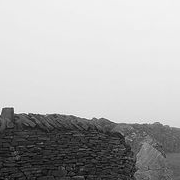

In [46]:
im = load_image('/Users/xiejiayu/Desktop/啥都有/学术/MSc/Project/train_set/29947219_76cc5bf766_gray.png')
array2pil(pil2array(im)[:,:,0])

In [122]:
x,y = test_pre.next_train_batch(batch_size=1,show_p=True,p=0.01)
newx = y - 15

0.01


In [129]:
array2pil(np.squeeze(x)).save("noise_001.png")

In [130]:
array2pil(np.squeeze(newx)).save("subtract.png")

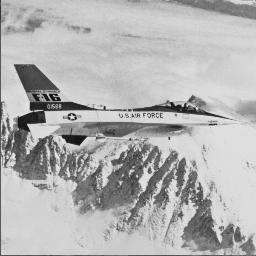

In [141]:
array2pil(np.squeeze(y))

In [125]:
np.mean(np.square(x-y))

201.09503

In [126]:
np.mean(np.square(newx-y))

225.0

In [151]:
print (np.mean(np.abs(x-y)))
print (np.mean(np.abs(midy-y)))
print (np.mean(np.abs(newx-y)))

1.2493286
4.234893798828125
15.0


In [146]:
import scipy.signal
midy = scipy.signal.medfilt(y[0,:,:], kernel_size=3)

In [150]:
array2pil(np.squeeze(midy)).save("blur.png")

In [152]:
print (np.mean(np.square(x-y)))
print (np.mean(np.square(midy-y)))
print (np.mean(np.square(newx-y)))

201.09503
108.18609619140625
225.0


In [155]:
print (np.mean(np.abs(x-y)))

1.2493286


In [17]:
test_pre = Preprocess('./Test/Set12',[256,256])
x,y = test_pre.test_batch()

./Test/Set12/01.png
./Test/Set12/03.png
./Test/Set12/02.png
./Test/Set12/06.png
./Test/Set12/12.png
./Test/Set12/07.png
./Test/Set12/11.png
./Test/Set12/05.png
./Test/Set12/04.png
./Test/Set12/10.png
./Test/Set12/09.png
./Test/Set12/08.png


In [18]:
x.shape

(120, 256, 256)

In [19]:
feed_dict = {model.x:x,model.y:y}
output,psnr = model.sess.run([model.output,model.psnr],feed_dict=feed_dict)

In [16]:
def show_images2(images):
    plt.figure(figsize=(40,int(80/32*images.shape[0]))) 
    for i in range(images.shape[0]):  
        plt.subplot(images.shape[0]/4,4,i+1)
        plt.imshow(np.squeeze(images[i,:,:]), cmap='gray')

In [199]:
scipy.io.savemat('test_set.mat', mdict={'x': x,'y':y})

In [23]:
import scipy.io
mat = scipy.io.loadmat('test_set.mat')
x = mat['x']
y = mat['y']
feed_dict = {model.x:x[:120,:,:],model.y:y[:120,:,:]}
output,psnr = model.sess.run([model.output,model.psnr],feed_dict=feed_dict)

In [20]:
psnr

26.594501

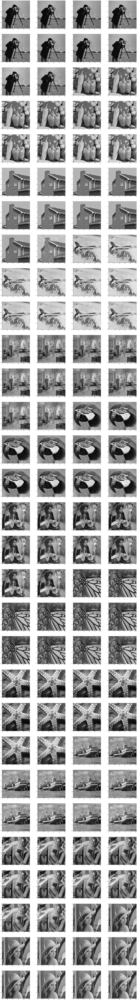

In [17]:
show_images2(np.squeeze(output))